### Final annotation of Mesenchymal cells (first trimester)


Preprocessing:
- mesenchymal cells from main object subsetted, then subsetted cells from first trimester patients
- performed scvi batch correction to prepare objects

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.5 scikit-learn==0.24.1 statsmodels==0.13.5 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2


In [3]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/post_scvi20221124/Mes_FT.hvg5000_noCC.scvi_output.with_annotv2.22021124.h5ad')

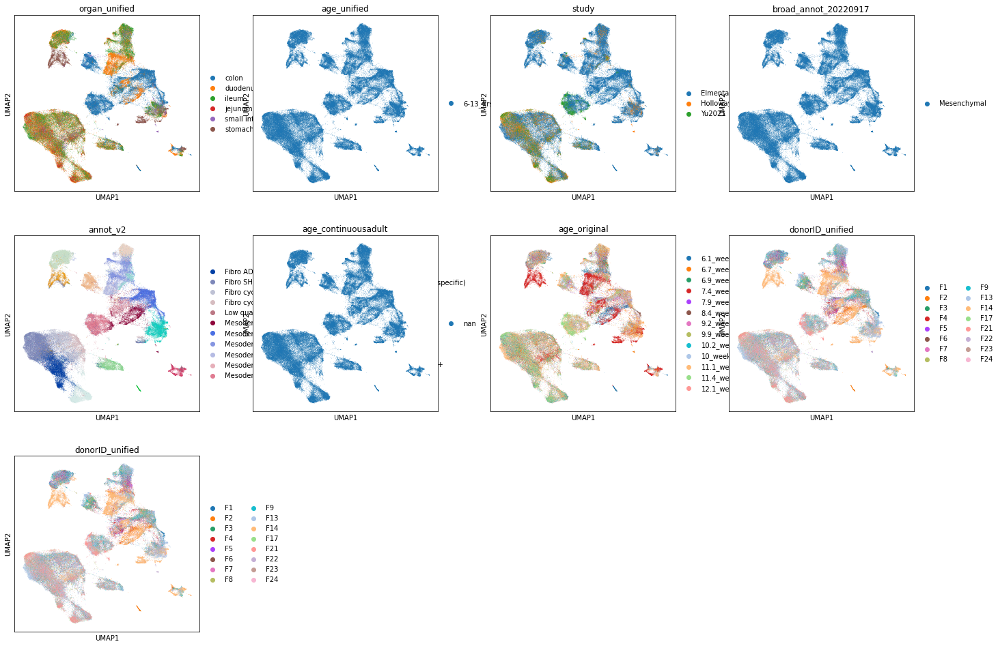

In [4]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata, color=['organ_unified', 'age_unified','study','broad_annot_20220917','annot_v2','age_continuousadult','age_original','donorID_unified','donorID_unified'],cmap='OrRd')

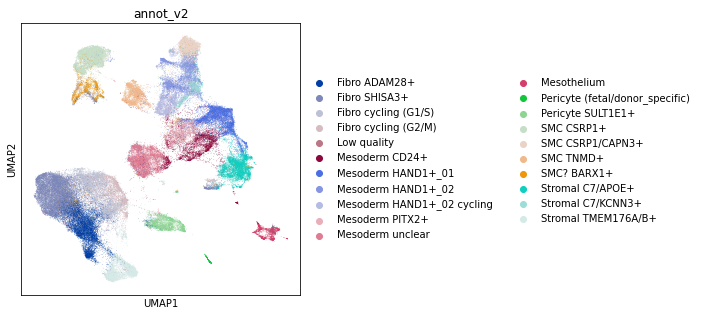

In [5]:
sc.pl.umap(adata,color='annot_v2')

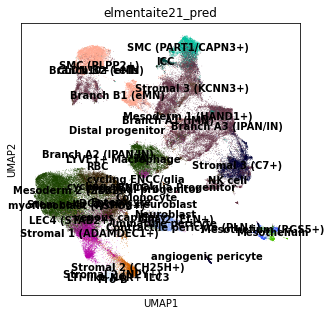

In [6]:
sc.pl.umap(adata, color=['elmentaite21_pred'],legend_loc='on data')

In [7]:
pd.set_option('display.max_rows', 500)
adata.obs.elmentaite21_pred.value_counts()

Mesoderm 1 (HAND1+)            33511
Mesoderm 2 (ZEB2+)             30875
SMC (PLPP2+)                   11723
cycling stromal                 9149
Stromal 3 (C7+)                 6642
Stromal 1 (ADAMDEC1+)           6437
SMC (PART1/CAPN3+)              4414
Stromal 2 (CH25H+)              3405
Immature pericyte               2827
Stromal 2 (NPY+)                2391
Stromal 3 (KCNN3+)              1841
Mesothelium (RGS5+)             1297
Mesothelium                      988
ICC                              938
Contractile pericyte (PLN+)      428
myofibroblast (RSPO2+)           182
angiogenic pericyte               86
Proximal progenitor               21
Branch B1 (eMN)                   11
Branch A1 (iMN)                   11
cDC2                               8
venous capillary                   7
ENCC/glia Progenitor               7
TA                                 6
cycling neuroblast                 5
LYVE1+ Macrophage                  4
cycling ENCC/glia                  4
B

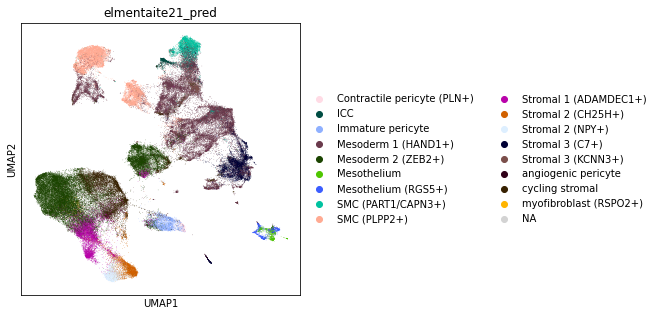

In [8]:
sc.pl.umap(adata,color=['elmentaite21_pred'],groups=['Mesoderm 1 (HAND1+)',
'Mesoderm 2 (ZEB2+)',
'SMC (PLPP2+)',
'cycling stromal',
'Stromal 3 (C7+)',
'Stromal 1 (ADAMDEC1+)',
'SMC (PART1/CAPN3+)',
'Stromal 2 (CH25H+)',
'Immature pericyte',
'Stromal 2 (NPY+)',
'Stromal 3 (KCNN3+)',
'Mesothelium (RGS5+)',
'Mesothelium',
'ICC',
'Contractile pericyte (PLN+)',
'myofibroblast (RSPO2+)',
'angiogenic pericyte'])

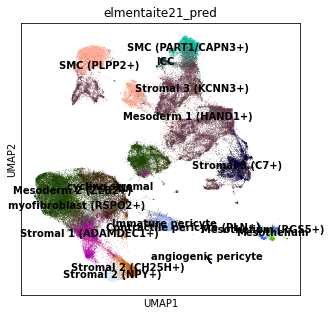

In [9]:
sc.pl.umap(adata,color=['elmentaite21_pred'],groups=['Mesoderm 1 (HAND1+)',
'Mesoderm 2 (ZEB2+)',
'SMC (PLPP2+)',
'cycling stromal',
'Stromal 3 (C7+)',
'Stromal 1 (ADAMDEC1+)',
'SMC (PART1/CAPN3+)',
'Stromal 2 (CH25H+)',
'Immature pericyte',
'Stromal 2 (NPY+)',
'Stromal 3 (KCNN3+)',
'Mesothelium (RGS5+)',
'Mesothelium',
'ICC',
'Contractile pericyte (PLN+)',
'myofibroblast (RSPO2+)',
'angiogenic pericyte'],legend_loc='on data')

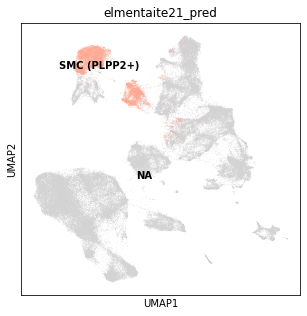

In [24]:
sc.pl.umap(adata,color=['elmentaite21_pred'],groups=[
'SMC (PLPP2+)'],legend_loc='on data')

In [10]:
adata.X.max()

#save raw counts in layers
adata.layers['counts'] = adata.X
#normalise and transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

In [12]:
adata.X.max()

8.814147

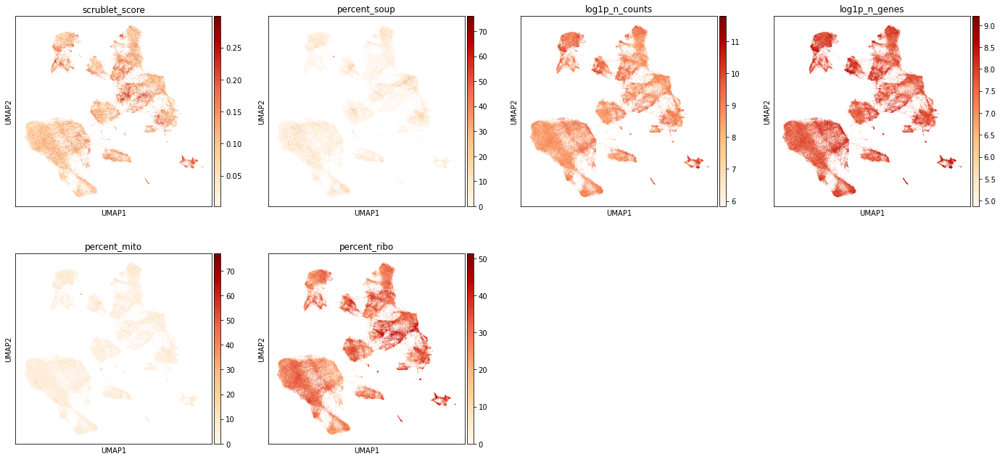

In [13]:
#plot some basic QC
sc.pl.umap(adata, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

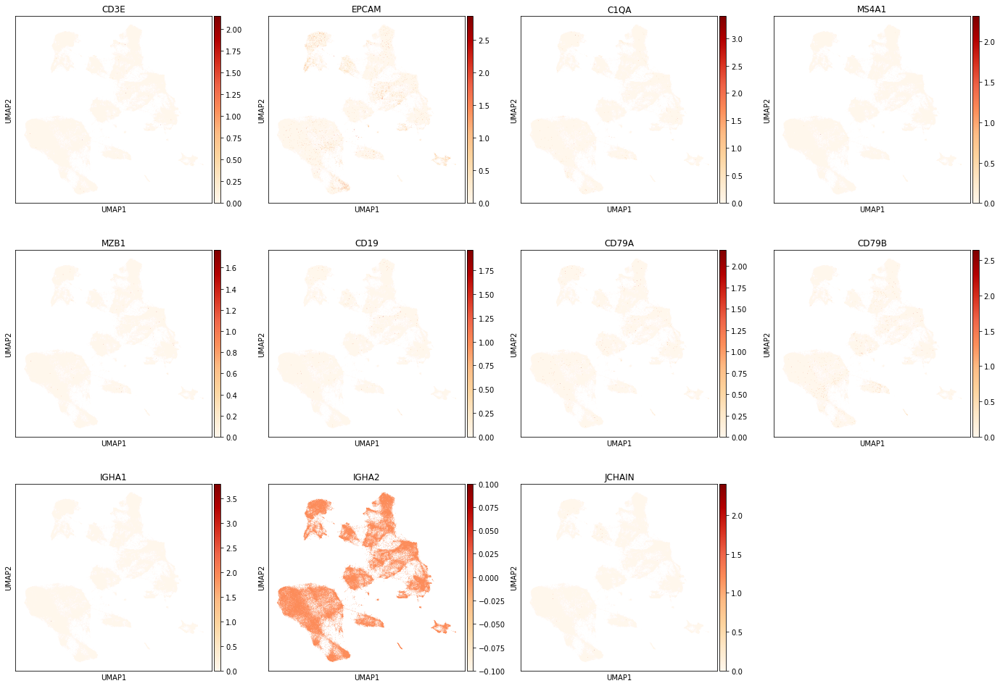

In [14]:
#plot doublet genes
sc.pl.umap(adata, color = ['CD3E','EPCAM','C1QA','MS4A1','MZB1','CD19','CD79A','CD79B','IGHA1','IGHA2','JCHAIN'],cmap='OrRd')

In [15]:
#score cell cycle genes
cell_cycle_genes = ['MCM5',
'PCNA',
 'TYMS',
 'FEN1',
 'MCM2',
 'MCM4',
 'RRM1',
 'UNG',
 'GINS2',
 'MCM6',
 'CDCA7',
 'DTL',
 'PRIM1',
 'UHRF1',
 'MLF1IP',
 'HELLS',
 'RFC2',
 'RPA2',
 'NASP',
 'RAD51AP1',
 'GMNN',
 'WDR76',
 'SLBP',
 'CCNE2',
 'UBR7',
 'POLD3',
 'MSH2',
 'ATAD2',
 'RAD51',
 'RRM2',
 'CDC45',
 'CDC6',
 'EXO1',
 'TIPIN',
 'DSCC1',
 'BLM',
 'CASP8AP2',
 'USP1',
 'CLSPN',
 'POLA1',
 'CHAF1B',
 'BRIP1',
 'E2F8',
 'HMGB2',
 'CDK1',
 'NUSAP1',
 'UBE2C',
 'BIRC5',
 'TPX2',
 'TOP2A',
 'NDC80',
 'CKS2',
 'NUF2',
 'CKS1B',
 'MKI67',
 'TMPO',
 'CENPF',
 'TACC3',
 'FAM64A',
 'SMC4',
 'CCNB2',
 'CKAP2L',
 'CKAP2',
 'AURKB',
 'BUB1',
 'KIF11',
 'ANP32E',
 'TUBB4B',
 'GTSE1',
 'KIF20B',
 'HJURP',
 'CDCA3',
 'HN1',
 'CDC20',
 'TTK',
 'CDC25C',
 'KIF2C',
 'RANGAP1',
 'NCAPD2',
 'DLGAP5',
 'CDCA2',
 'CDCA8',
 'ECT2',
 'KIF23',
 'HMMR',
 'AURKA',
 'PSRC1',
 'ANLN',
 'LBR',
 'CKAP5',
 'CENPE',
 'CTCF',
 'NEK2',
 'G2E3',
 'GAS2L3',
 'CBX5',
 'CENPA']

In [16]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)
adata = adata[adata.obs.G2M_score.sort_values(ascending=True).index].copy()

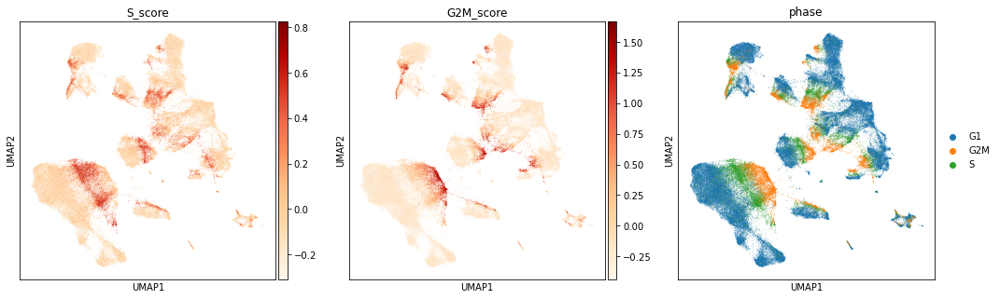

In [17]:
sc.pl.umap(adata,color=['S_score', 'G2M_score', 'phase'],cmap='OrRd')

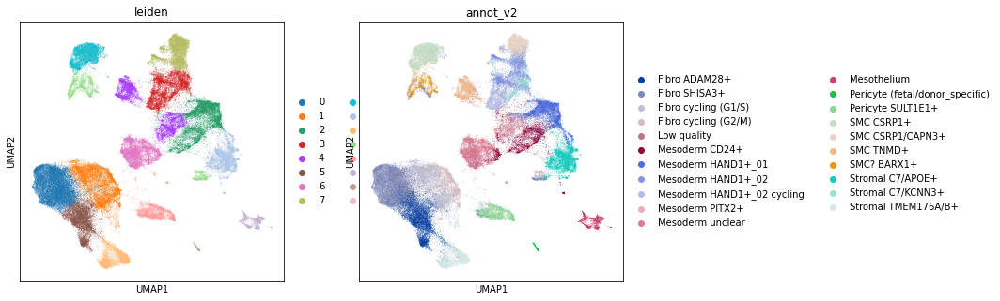

In [18]:
sc.tl.leiden(adata, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(adata,color=['leiden','annot_v2'])

In [19]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *

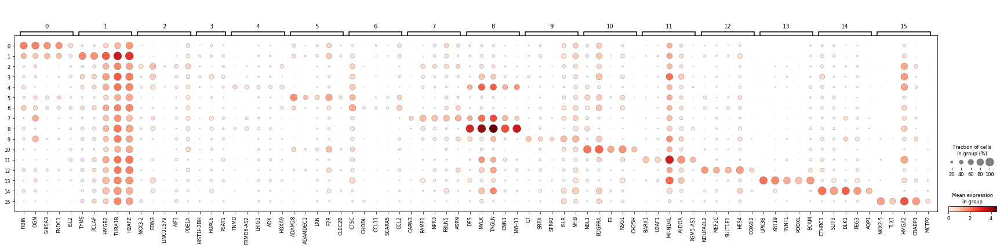

In [20]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden', mks=mks)

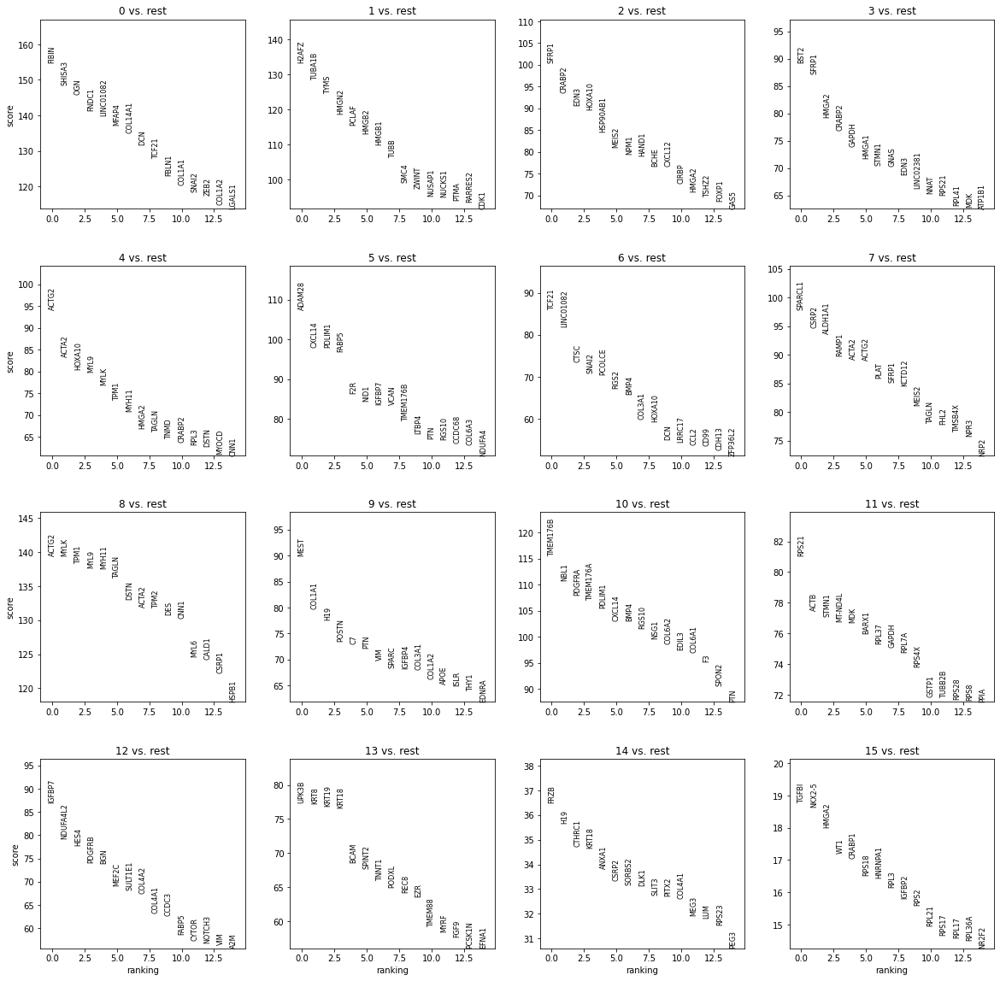

In [21]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False)

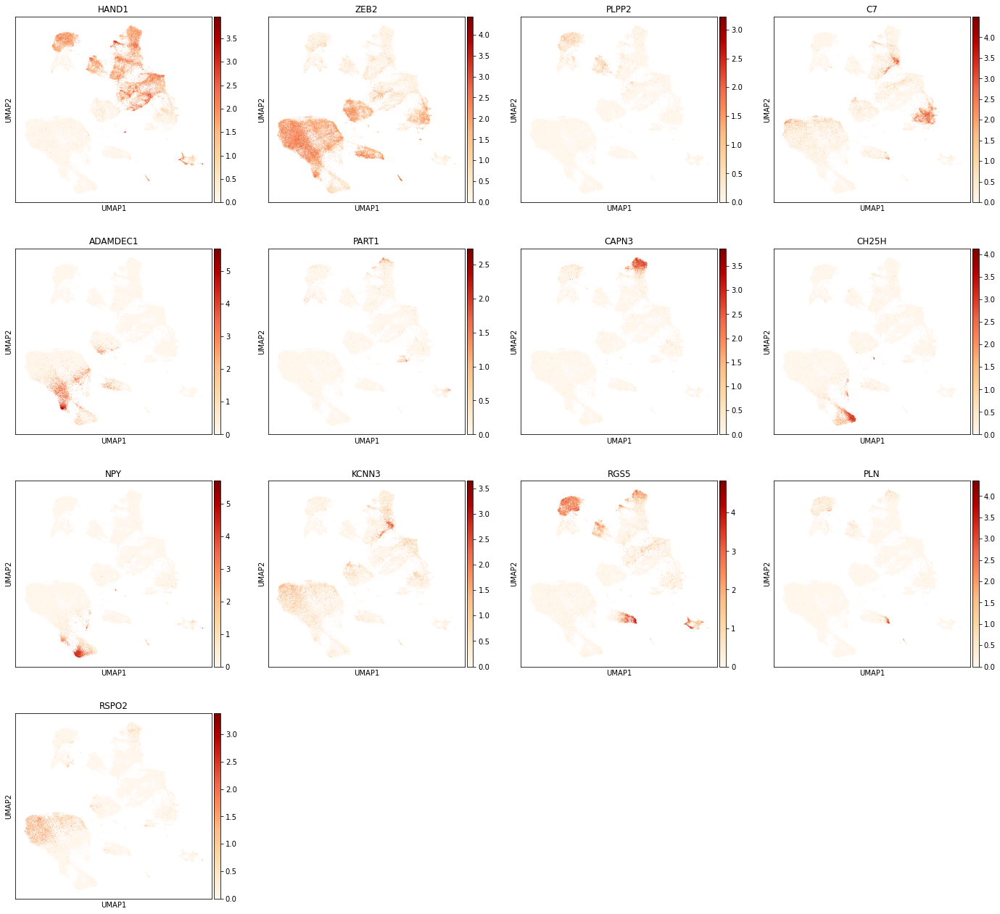

In [23]:
sc.pl.umap(adata,color=['HAND1',
'ZEB2',
'PLPP2',
'C7',
'ADAMDEC1',
'PART1', 'CAPN3',
'CH25H',
'NPY',
'KCNN3',
'RGS5',
'PLN',
'RSPO2'],cmap='OrRd')

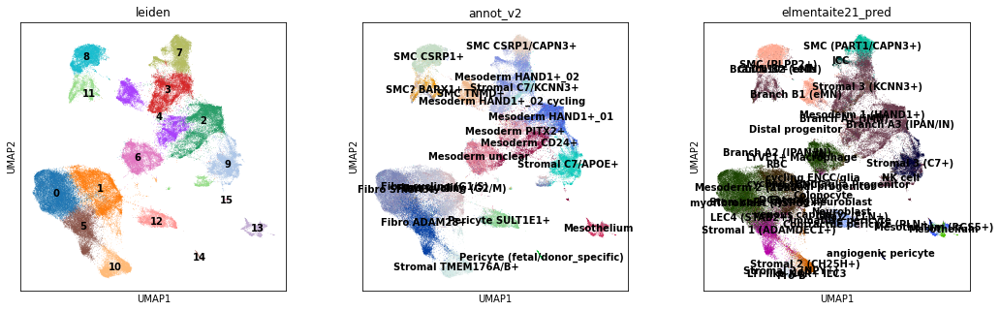

In [26]:
sc.pl.umap(adata,color=['leiden','annot_v2','elmentaite21_pred'],legend_loc='on data')

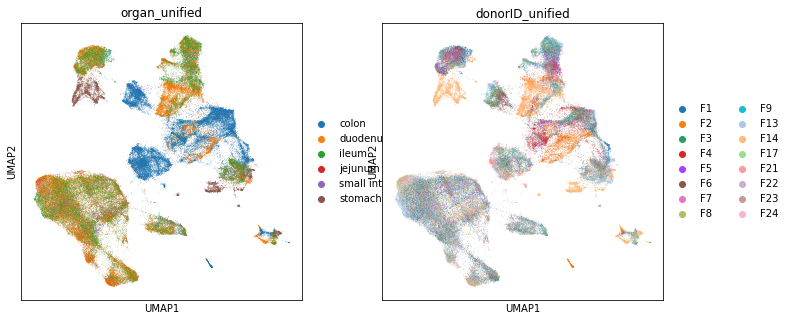

In [28]:
sc.pl.umap(adata,color=['organ_unified','donorID_unified'])

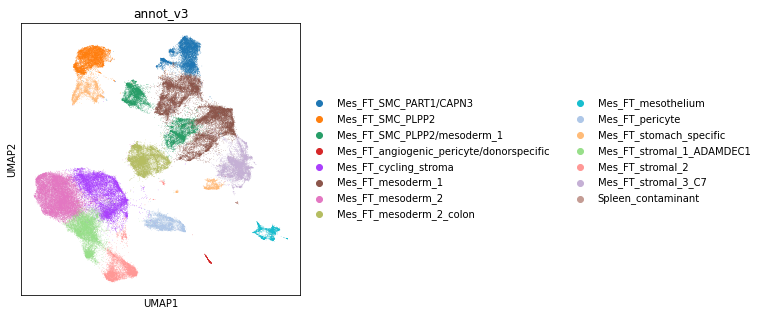

In [29]:
new_cluster_names = [
    'Mes_FT_mesoderm_2','Mes_FT_cycling_stroma', #0,1
    'Mes_FT_mesoderm_1','Mes_FT_mesoderm_1', #2,3
    'Mes_FT_SMC_PLPP2/mesoderm_1','Mes_FT_stromal_1_ADAMDEC1', #4,5
    'Mes_FT_mesoderm_2_colon','Mes_FT_SMC_PART1/CAPN3', #6,7 
   'Mes_FT_SMC_PLPP2','Mes_FT_stromal_3_C7',#8,9
    'Mes_FT_stromal_2','Mes_FT_stomach_specific',#10,11
    'Mes_FT_pericyte','Mes_FT_mesothelium',#12,13
    'Mes_FT_angiogenic_pericyte/donorspecific','Spleen_contaminant'#14,15



]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

adata.obs['annot_v3'] = [conv[x] for x in adata.obs['leiden']]
sc.pl.umap(adata,color='annot_v3')

In [34]:
smc1 = adata[adata.obs.annot_v3.isin(['Mes_FT_SMC_PART1/CAPN3'])].copy()

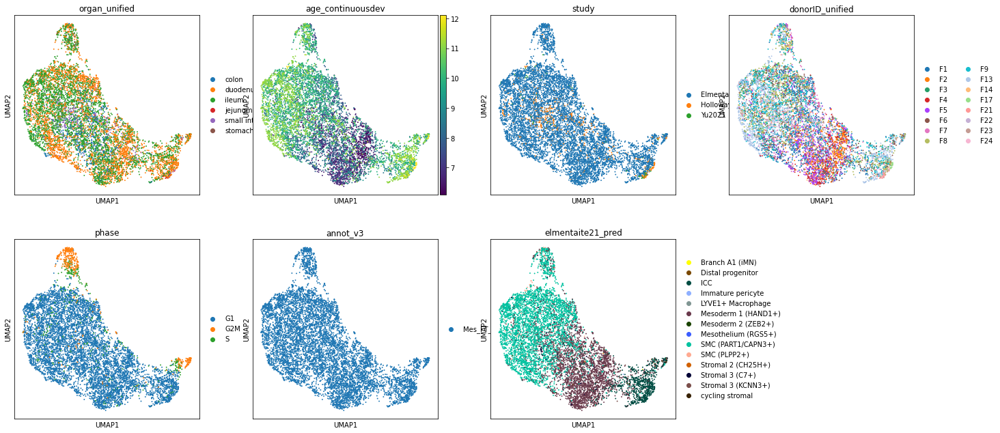

In [43]:
sc.pp.neighbors(
        smc1,
            use_rep="X_scvi",
            n_pcs=smc1.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(smc1, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(smc1, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase','annot_v3','elmentaite21_pred'])

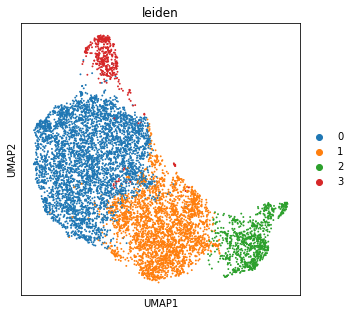

In [36]:
sc.tl.leiden(smc1, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(smc1, color=['leiden'])

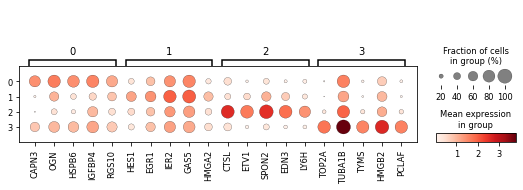

In [37]:
smc1.raw = smc1.copy()
mkst = calc_marker_stats(smc1, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(smc1, groupby='leiden', mks=mks)

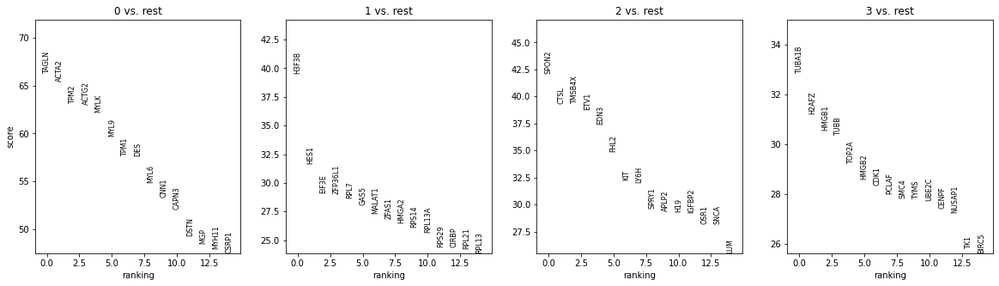

In [38]:
sc.tl.rank_genes_groups(smc1, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(smc1, n_genes=15, sharey=False)

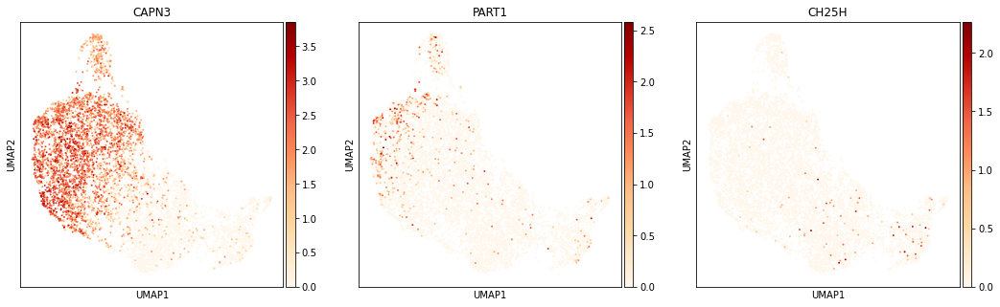

In [42]:
sc.pl.umap(smc1,color=['CAPN3','PART1','CH25H'],cmap='OrRd')

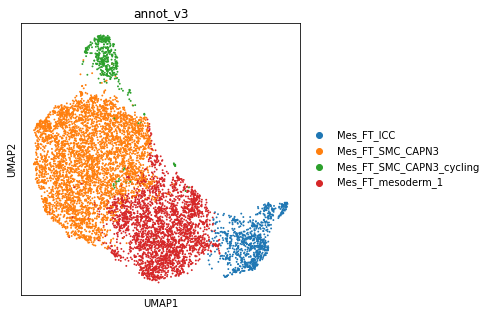

In [44]:
new_cluster_names = [
    'Mes_FT_SMC_CAPN3','Mes_FT_mesoderm_1', #0,1
    'Mes_FT_ICC','Mes_FT_SMC_CAPN3_cycling' #2,3



]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

smc1.obs['annot_v3'] = [conv[x] for x in smc1.obs['leiden']]
sc.pl.umap(smc1,color='annot_v3')

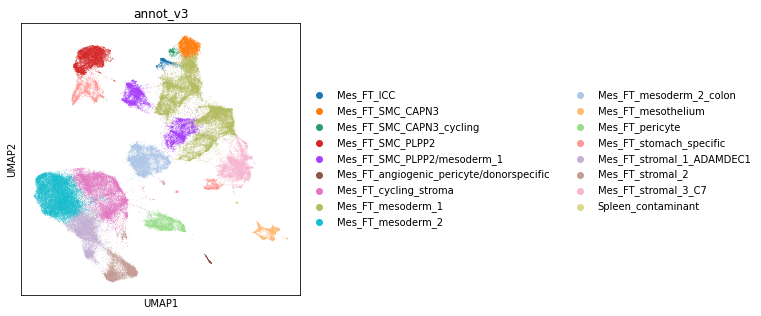

In [45]:
ON = {O:N for O,N in zip(smc1.obs_names,smc1.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [61]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/DRAFTMes_FT.hvg5000_noRPL.scvi_output.annotv3.20221201.h5ad')

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/DRAFTMes_FT.hvg5000_noRPL.scvi_output.annotv3.20221201.h5ad')

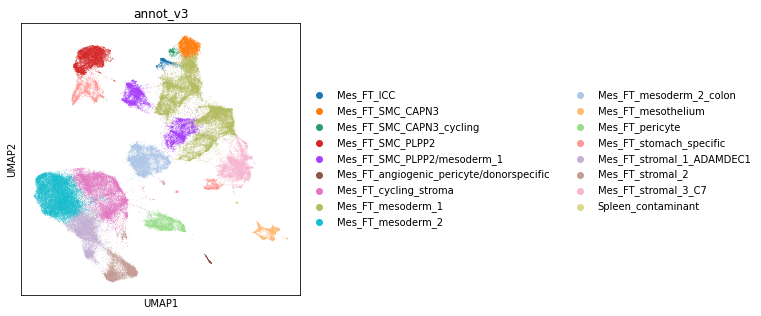

In [4]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='annot_v3')

In [5]:
smc2 = adata[adata.obs.annot_v3.isin(['Mes_FT_SMC_PLPP2','Mes_FT_stomach_specific','Mes_FT_SMC_PLPP2/mesoderm_1'])].copy()

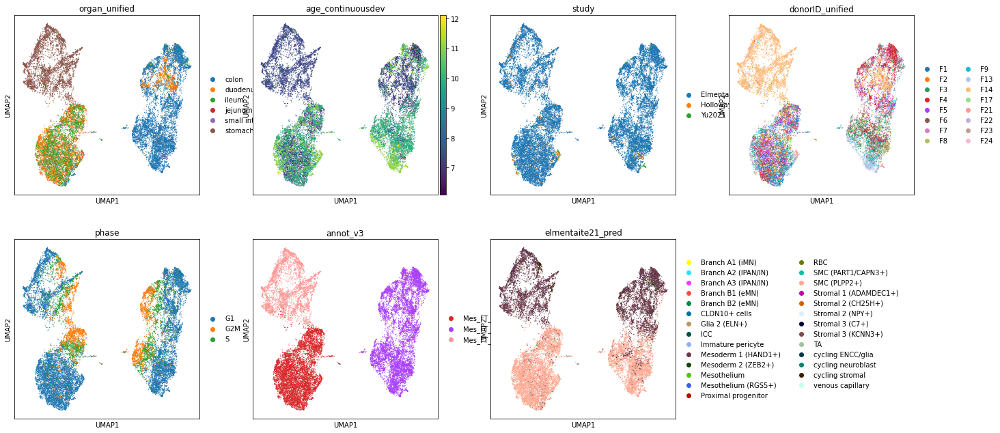

In [6]:
sc.pp.neighbors(
        smc2,
            use_rep="X_scvi",
            n_pcs=smc2.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(smc2, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(smc2, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase','annot_v3','elmentaite21_pred'])

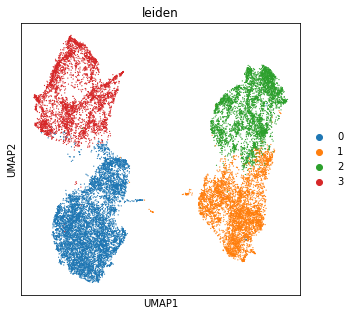

In [7]:
sc.tl.leiden(smc2, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(smc2, color=['leiden'])

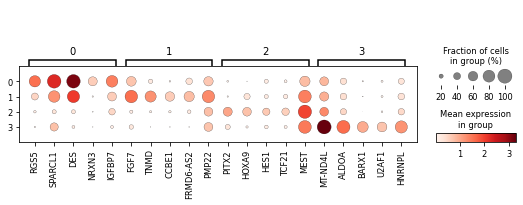

In [51]:
smc2.raw = smc2.copy()
mkst = calc_marker_stats(smc2, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(smc2, groupby='leiden', mks=mks)

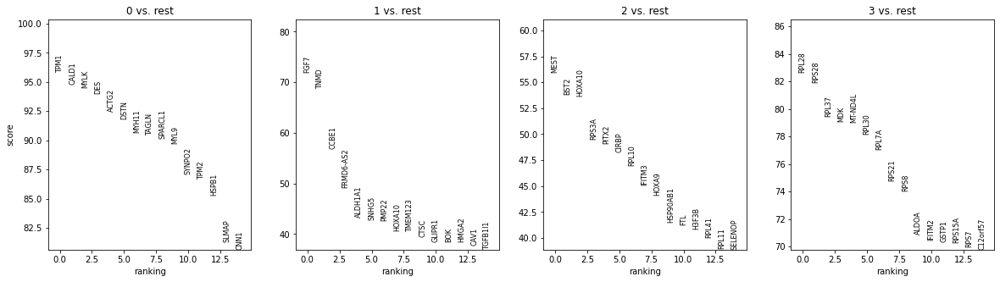

In [52]:
sc.tl.rank_genes_groups(smc2, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(smc2, n_genes=15, sharey=False)

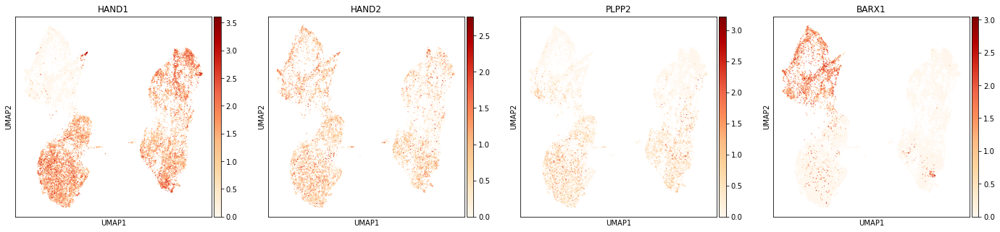

In [59]:
sc.pl.umap(smc2,color=['HAND1','HAND2','PLPP2','BARX1'],cmap='OrRd')
#https://www.genecards.org/cgi-bin/carddisp.pl?gene=BARX1 - stomach organogenesis

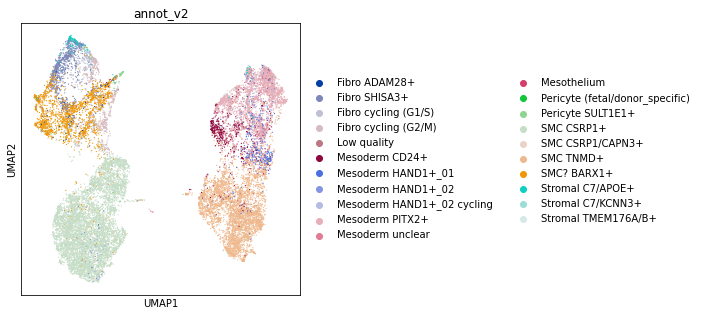

In [8]:
sc.pl.umap(smc2,color='annot_v2')

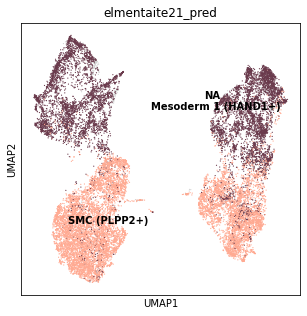

In [16]:
sc.pl.umap(smc2,color='elmentaite21_pred',legend_loc='on data',groups=['Mesoderm 1 (HAND1+)','SMC (PLPP2+)'])

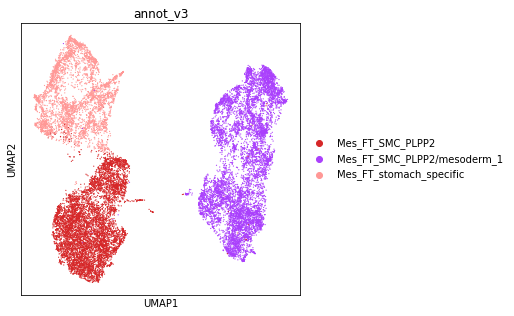

In [17]:
sc.pl.umap(smc2,color='annot_v3')

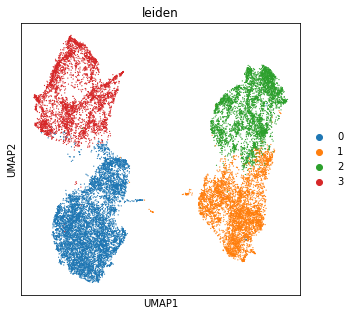

In [18]:
sc.pl.umap(smc2, color=['leiden'])

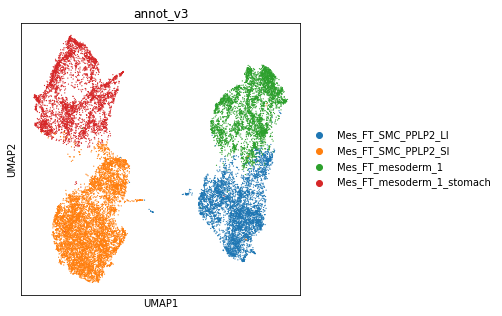

In [19]:
new_cluster_names = [
    'Mes_FT_SMC_PPLP2_SI','Mes_FT_SMC_PPLP2_LI', #0,1
    'Mes_FT_mesoderm_1','Mes_FT_mesoderm_1_stomach' #2,3



]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

smc2.obs['annot_v3'] = [conv[x] for x in smc2.obs['leiden']]
sc.pl.umap(smc2,color='annot_v3')

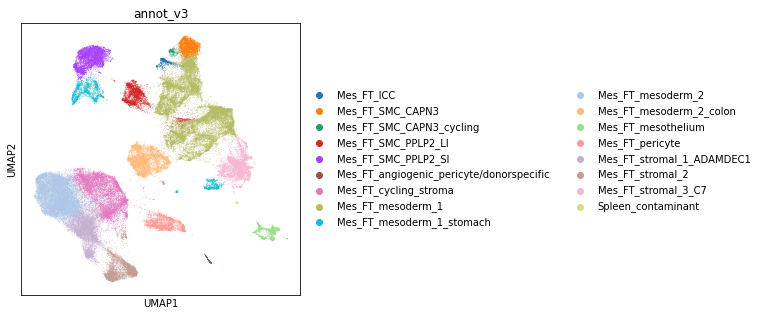

In [20]:
ON = {O:N for O,N in zip(smc2.obs_names,smc2.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

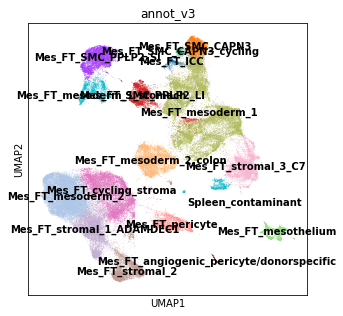

In [21]:
sc.pl.umap(adata,color='annot_v3',legend_loc='on data')

In [22]:
meso1 = adata[adata.obs.annot_v3.isin(['Mes_FT_mesoderm_1'])].copy()

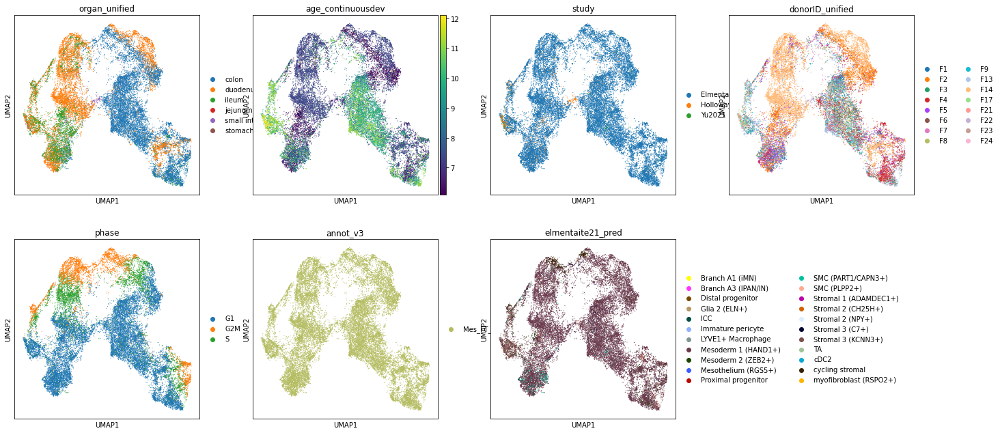

In [23]:
sc.pp.neighbors(
        meso1,
            use_rep="X_scvi",
            n_pcs=meso1.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(meso1, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(meso1, color=['organ_unified', 'age_continuousdev','study','donorID_unified','phase','annot_v3','elmentaite21_pred'])

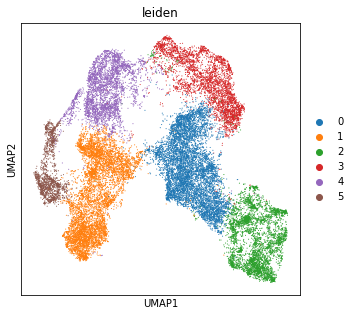

In [27]:
sc.tl.leiden(meso1, resolution = 0.3, neighbors_key="neighbors_scvi")
sc.pl.umap(meso1, color=['leiden'])

In [29]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *

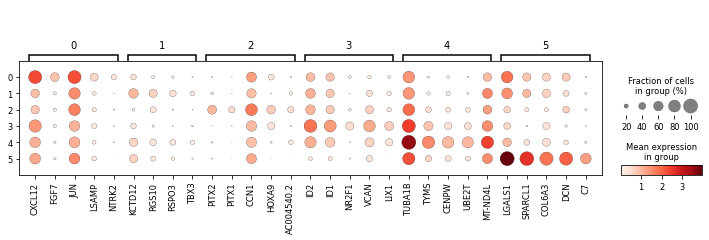

In [30]:
meso1.raw = meso1.copy()
mkst = calc_marker_stats(meso1, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(meso1, groupby='leiden', mks=mks)

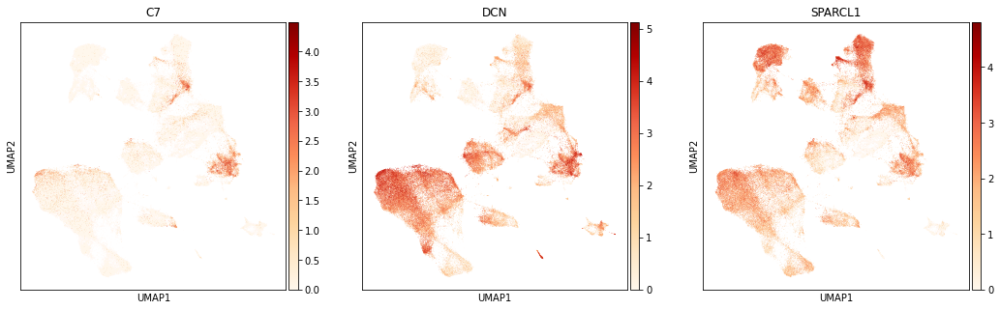

In [33]:
sc.pl.umap(adata,color=['C7','DCN','SPARCL1'],cmap='OrRd')

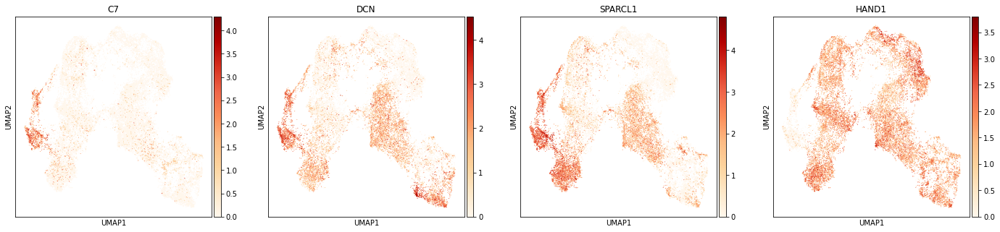

In [35]:
sc.pl.umap(meso1,color=['C7','DCN','SPARCL1','HAND1'],cmap='OrRd')

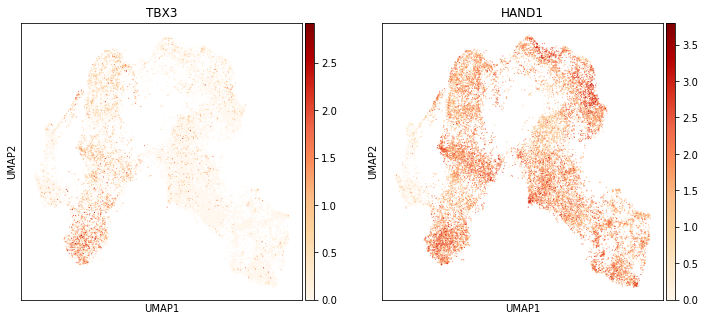

In [38]:
sc.pl.umap(meso1,color=['TBX3','HAND1'],cmap='OrRd')

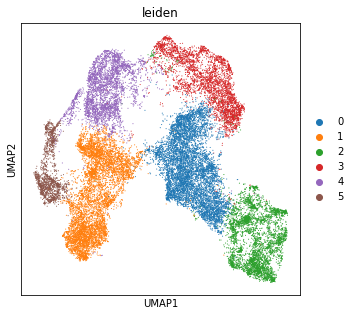

In [37]:
sc.pl.umap(meso1,color='leiden')

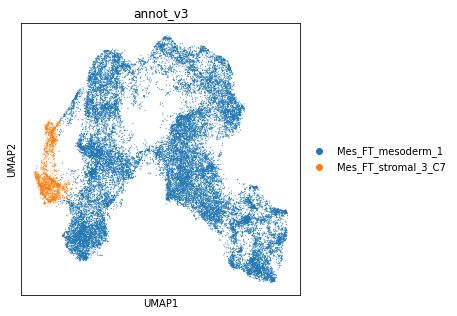

In [43]:
new_cluster_names = [
    'Mes_FT_mesoderm_1','Mes_FT_mesoderm_1', #0,1
    'Mes_FT_mesoderm_1','Mes_FT_mesoderm_1', #2,3
    'Mes_FT_mesoderm_1','Mes_FT_stromal_3_C7' #4,5



]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

meso1.obs['annot_v3'] = [conv[x] for x in meso1.obs['leiden']]
sc.pl.umap(meso1,color='annot_v3')

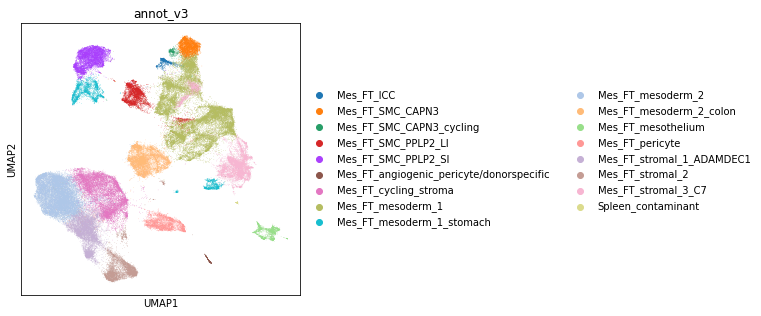

In [44]:
ON = {O:N for O,N in zip(meso1.obs_names,meso1.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

Make names consistent with adult stromal cells - went away from stromal 1/2/3 naming and made consistent with other literature

In [45]:
adata.obs['annot_v3'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {'Mes_FT_cycling_stroma':'Mes_AP_cycling_fibroblast',
                    'Mes_FT_stromal_1_ADAMDEC1':'Mes_FT_lamina_propria_fibroblast_ADAMDEC1',
                    'Mes_FT_stromal_2':'Mes_FT_villus_fibroblast_F3',
                    'Mes_FT_stromal_3_C7':'Mes_FT_crypt_fibroblast_PI16'
                    
   }.get(x, x))
    .astype("category")
)

In [46]:
adata.obs['annot_v3'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {'Spleen_contaminant':'Doublets'
                    
   }.get(x, x))
    .astype("category")
)

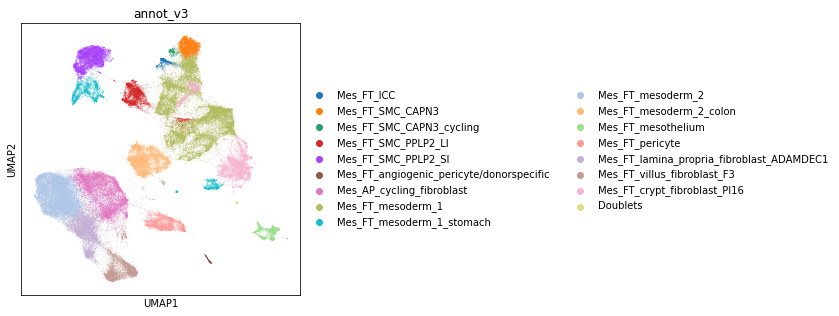

In [47]:
sc.pl.umap(adata,color='annot_v3')

In [48]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Mes_FT.hvg5000_noRPL.scvi_output.annotv3.202301056.h5ad')

In [49]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [50]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/Mes_FT_annot_v3.csv')

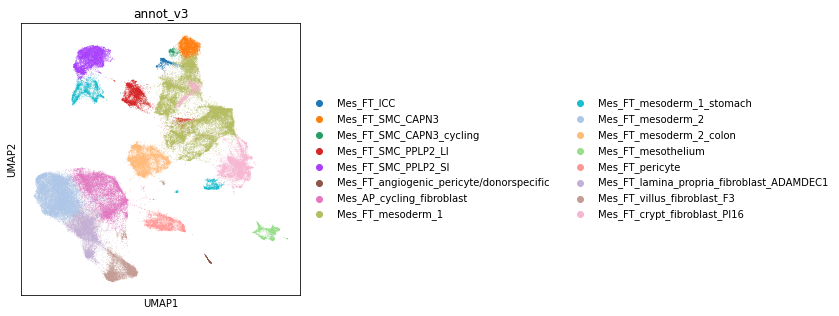

In [51]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [52]:
adata_nodoublets.X.max()

8.814147

In [53]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [54]:
adata_nodoublets.X.max()

4715.0

In [56]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/Mes_FT.raw.annotv3.nodoublets.20230105.h5ad')

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Mes_FT.hvg5000_noRPL.scvi_output.annotv3.202301056.h5ad')

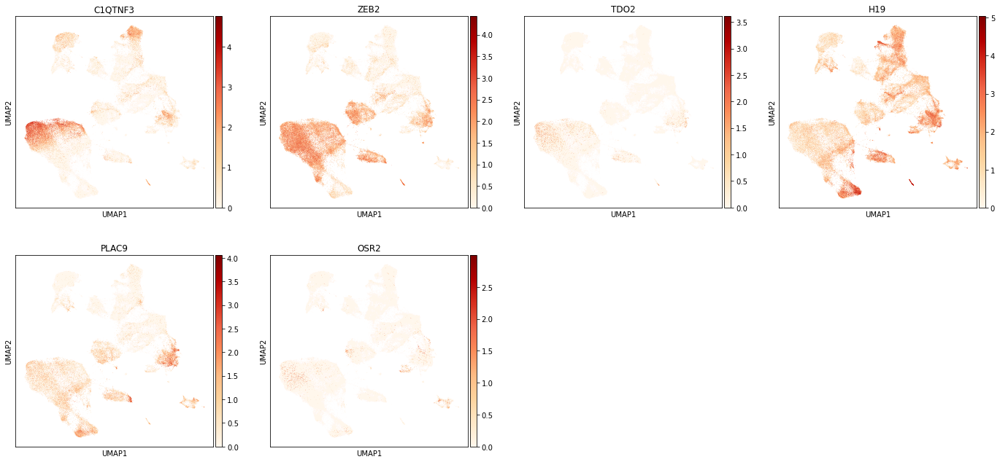

In [8]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color=['C1QTNF3','ZEB2','TDO2','H19','PLAC9','OSR2'],cmap='OrRd')

In [2]:
#make plots for figure

In [3]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Mes_FT.hvg5000_noRPL.scvi_output.annotv3.202301056.h5ad')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


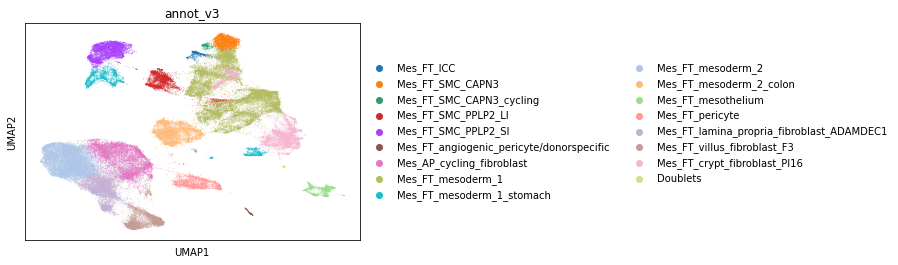

In [4]:
sc.pl.umap(adata,color='annot_v3')

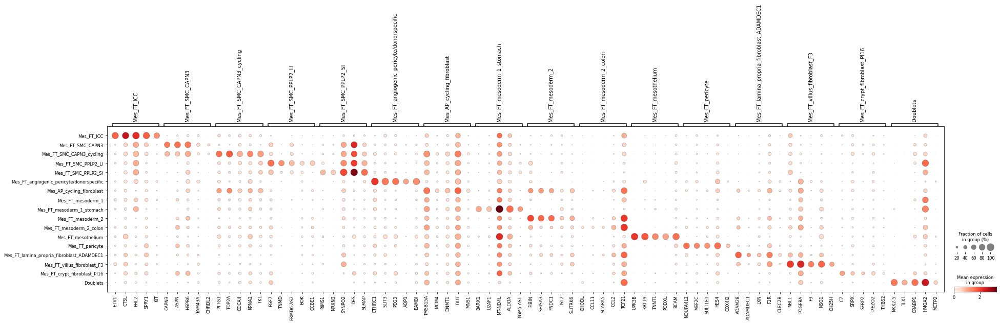

In [5]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="annot_v3")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='annot_v3', mks=mks)

In [6]:
adata.obs['annot_v3'] = adata.obs['annot_v3'].str.replace('Mes_FT_', '')

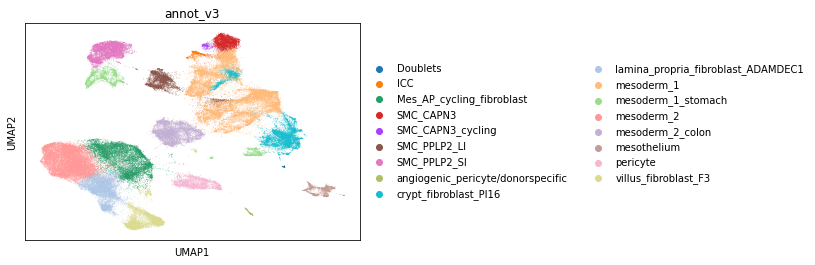

In [7]:
sc.pl.umap(adata,color='annot_v3')

In [8]:
adata.obs.annot_v3.cat.categories

Index(['Doublets', 'ICC', 'Mes_AP_cycling_fibroblast', 'SMC_CAPN3',
       'SMC_CAPN3_cycling', 'SMC_PPLP2_LI', 'SMC_PPLP2_SI',
       'angiogenic_pericyte/donorspecific', 'crypt_fibroblast_PI16',
       'lamina_propria_fibroblast_ADAMDEC1', 'mesoderm_1',
       'mesoderm_1_stomach', 'mesoderm_2', 'mesoderm_2_colon', 'mesothelium',
       'pericyte', 'villus_fibroblast_F3'],
      dtype='object')

In [9]:
adata = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()

In [10]:
adata.obs.annot_v3.cat.categories

Index(['ICC', 'Mes_AP_cycling_fibroblast', 'SMC_CAPN3', 'SMC_CAPN3_cycling',
       'SMC_PPLP2_LI', 'SMC_PPLP2_SI', 'angiogenic_pericyte/donorspecific',
       'crypt_fibroblast_PI16', 'lamina_propria_fibroblast_ADAMDEC1',
       'mesoderm_1', 'mesoderm_1_stomach', 'mesoderm_2', 'mesoderm_2_colon',
       'mesothelium', 'pericyte', 'villus_fibroblast_F3'],
      dtype='object')

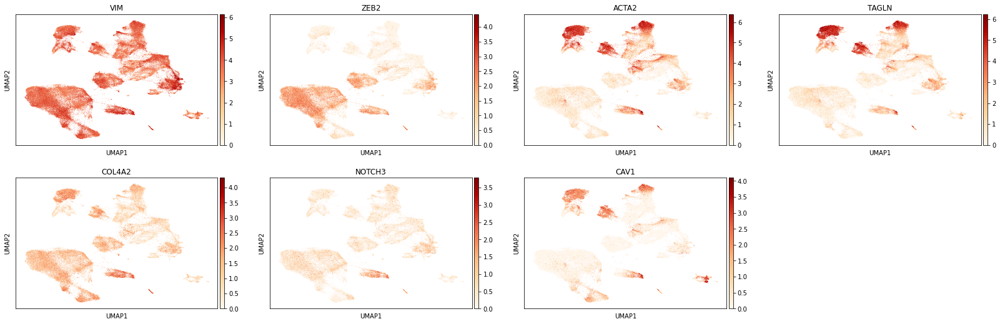

In [12]:
#angiogenic pericyte markers
sc.pl.umap(adata,color=['VIM','ZEB2','ACTA2','TAGLN','COL4A2','NOTCH3','CAV1'],cmap='OrRd')

In [13]:
pd.crosstab(adata.obs.donorID_unified,adata.obs.annot_v3)

annot_v3,ICC,Mes_AP_cycling_fibroblast,SMC_CAPN3,SMC_CAPN3_cycling,SMC_PPLP2_LI,SMC_PPLP2_SI,angiogenic_pericyte/donorspecific,crypt_fibroblast_PI16,lamina_propria_fibroblast_ADAMDEC1,mesoderm_1,mesoderm_1_stomach,mesoderm_2,mesoderm_2_colon,mesothelium,pericyte,villus_fibroblast_F3
donorID_unified,,,,,,,,,,,,,,,,
F1,60,1123,563,38,148,1060,0,916,560,1392,1,1584,255,33,351,223
F2,0,268,38,9,21,503,467,319,26,4205,13,182,38,255,29,9
F3,20,114,138,24,438,167,0,127,93,346,5,132,121,69,36,177
F4,1,253,34,9,286,822,2,193,49,2461,3,253,121,44,32,63
F5,3,329,77,16,142,864,0,38,53,1317,5,304,59,12,31,52
F6,84,873,294,16,634,520,0,437,628,1412,2,1121,511,70,338,459
F7,12,147,208,29,295,509,0,354,61,1368,5,137,202,22,37,47
F8,126,1208,726,89,1110,594,1,839,730,1844,19,1584,1603,205,526,496
F9,163,1000,803,108,710,1138,2,783,628,1562,8,1415,1018,187,508,396


In [14]:
#remove angiogenic pericyte, only coming from one donor

In [15]:
adata = adata[~adata.obs.annot_v3.isin(['angiogenic_pericyte/donorspecific'])].copy()

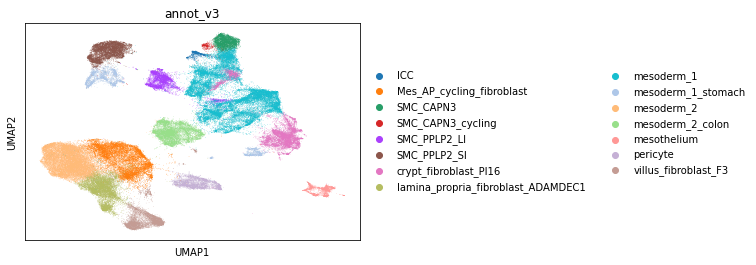

In [16]:
sc.pl.umap(adata,color='annot_v3')

In [17]:
adata.obs['annot_v3'].cat.reorder_categories([
    'mesoderm_1',
       'mesoderm_1_stomach', 'mesoderm_2', 'mesoderm_2_colon',
    'SMC_CAPN3',
       'SMC_CAPN3_cycling', 'SMC_PPLP2_LI', 'SMC_PPLP2_SI',
      'pericyte', 

    
     'Mes_AP_cycling_fibroblast',  'crypt_fibroblast_PI16',
       'lamina_propria_fibroblast_ADAMDEC1',  
     'villus_fibroblast_F3','ICC','mesothelium'
       ], inplace=True)


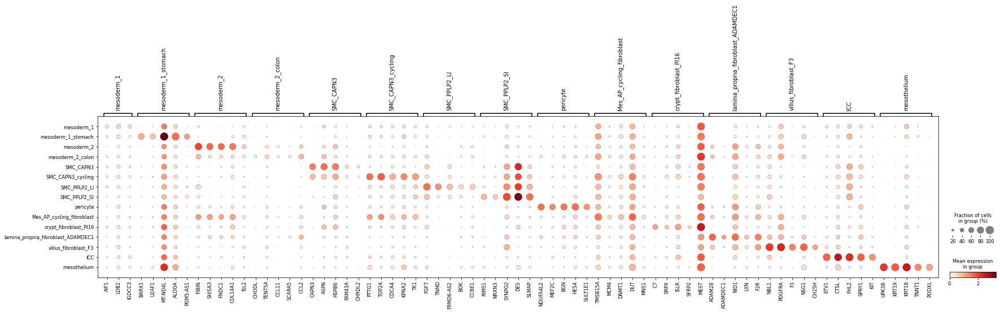

In [18]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="annot_v3")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='annot_v3', mks=mks)

In [19]:
annot = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/healthy_annotations_level1to3_20230127.csv',index_col=0)

In [20]:
annot

,level_1_annot,level_2_annot,level_3_annot
index,,,
AAACGAATCTCTTGCG-GSM4600896,Endothelial,Vascular_endothelia,EC_venous
AAACGCTAGCGACCCT-GSM4600896,Myeloid,Granulocyte,Mast
AAAGAACAGCGACCCT-GSM4600896,Endothelial,Vascular_endothelia,EC_capillary
AAAGGGCAGTCACACT-GSM4600896,Myeloid,Granulocyte,Mast
AAAGGGCCAACACAGG-GSM4600896,Myeloid,DC,DC_cDC1
...,...,...,...
TTTGTCAAGAACAACT-GSM5525958,T and NK cells,Conventional_CD4,Trm_CD4
TTTGTCAAGATAGGAG-GSM5525958,B and B plasma,B_plasma,B_plasma_IgA1
TTTGTCAAGTAGGCCA-GSM5525958,B and B plasma,B_plasma,B_plasma_IgA1


In [21]:
adata.obs['fine_annot'] = annot.level_3_annot

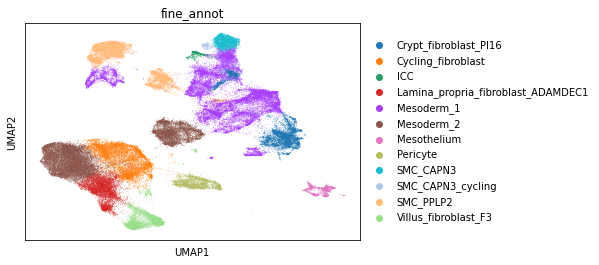

In [22]:
sc.pl.umap(adata,color='fine_annot')

In [43]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Mes_FT.hvg5000_noRPL.scvi_output.annotv3.202301056.h5ad')

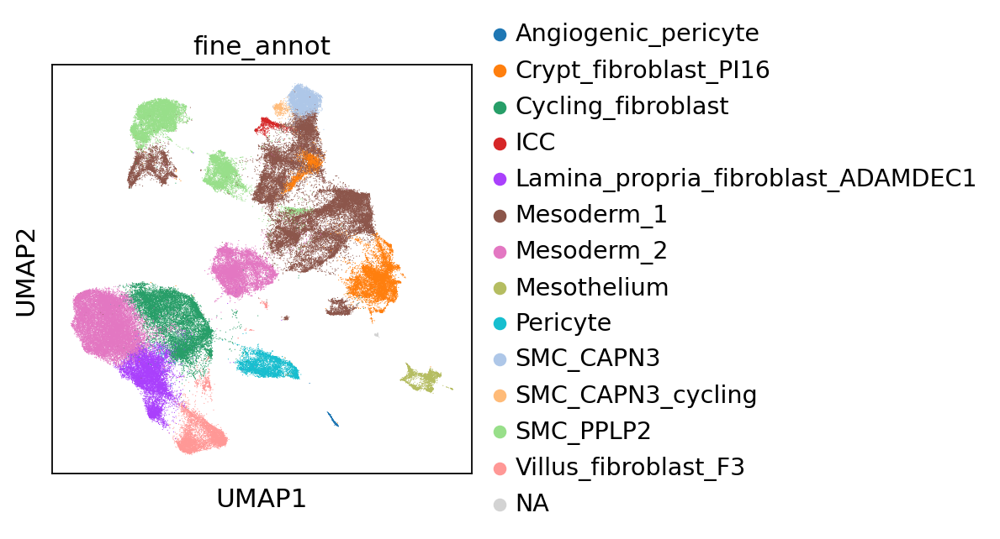

In [44]:
adata.obs['fine_annot'] = annot.level_3_annot
sc.pl.umap(adata,color='fine_annot')

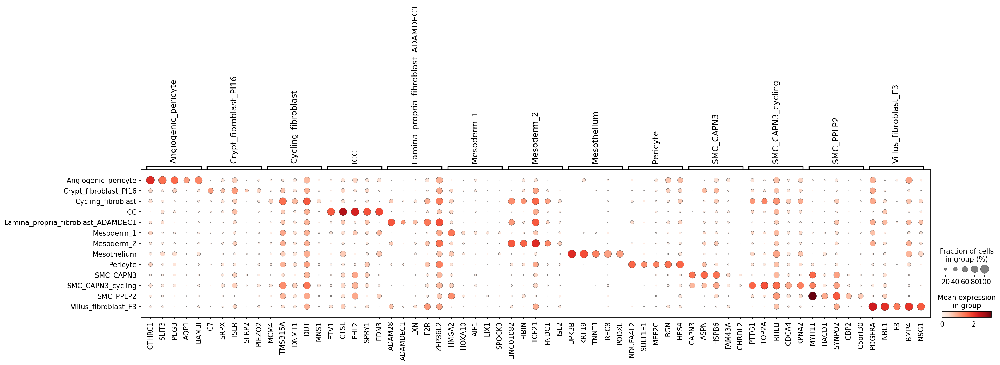

In [45]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="fine_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='fine_annot', mks=mks)

In [46]:
adata.obs.fine_annot.cat.categories

Index(['Angiogenic_pericyte', 'Crypt_fibroblast_PI16', 'Cycling_fibroblast',
       'ICC', 'Lamina_propria_fibroblast_ADAMDEC1', 'Mesoderm_1', 'Mesoderm_2',
       'Mesothelium', 'Pericyte', 'SMC_CAPN3', 'SMC_CAPN3_cycling',
       'SMC_PPLP2', 'Villus_fibroblast_F3'],
      dtype='object')

In [47]:
adata.obs['fine_annot'].cat.reorder_categories(['Pericyte','Angiogenic_pericyte','SMC_CAPN3', 'SMC_CAPN3_cycling',
       'SMC_PPLP2','Villus_fibroblast_F3',
                                                'Crypt_fibroblast_PI16','Lamina_propria_fibroblast_ADAMDEC1',
                                                
      'Mesoderm_1', 'Mesoderm_2','Cycling_fibroblast',
       'Mesothelium',     'ICC'
       ], inplace=True)


In [48]:
marker_genes_dict = {
    
                     #'Vascular_smooth_muscle':['RERGL','MUSTN1','LBH','NET1','MAP3K20'],
                     'Pericyte':['NDUFA4L2','SULT1E1','MEF2C','COX4I2','HIGD1B','RGS5'],
    'SMC_CAPN3':['CAPN3','ASPN','HSPB6'],
                      'cycling markers':['TOP2A','MKI67'],
    'SMC_PLPP2':['PLPP2','MYH11','HACD1','GBP2'],
                     #'Immune_recruiting_pericyte':['GPC3','COL14A1','ECRG4','ID4','FHL2','CXCL12'],
                     #'Myofibroblast':['ACTG2','HHIP','SOSTDC1','NPNT'],
                     #'Follicular_DC':['FDCSP','SRGN','CR2','CLU','CSTA'],
                     #'Stromal_fibroblast_retictular':['CCL21','CCL19','TNFSF13B','TDO2'],
                     'Villus_fibroblast_F3':['F3','PDGFRA'],
                     'Crypt_fibroblast_PI16':['C7','SFRP2'],
                     'Lamina_propria_fibroblast_ADAMDEC1':['ADAMDEC1','ADAM28'],
                     
    
    
    'Mesoderm_1':['HAND1','HOXA10','LIX1','SPOCK3'],
    
   'Mesoderm_2':['ZEB2','FIBIN','FNDC1','C1QTNF3'],
    
              'Mesothelium':['UPK3B','MSLN','SLPI','KRT19'],
    
    
   
    'ICC':['KIT','ETV1','CTSL','FHL2']
                     
                     
                     
    
                    }

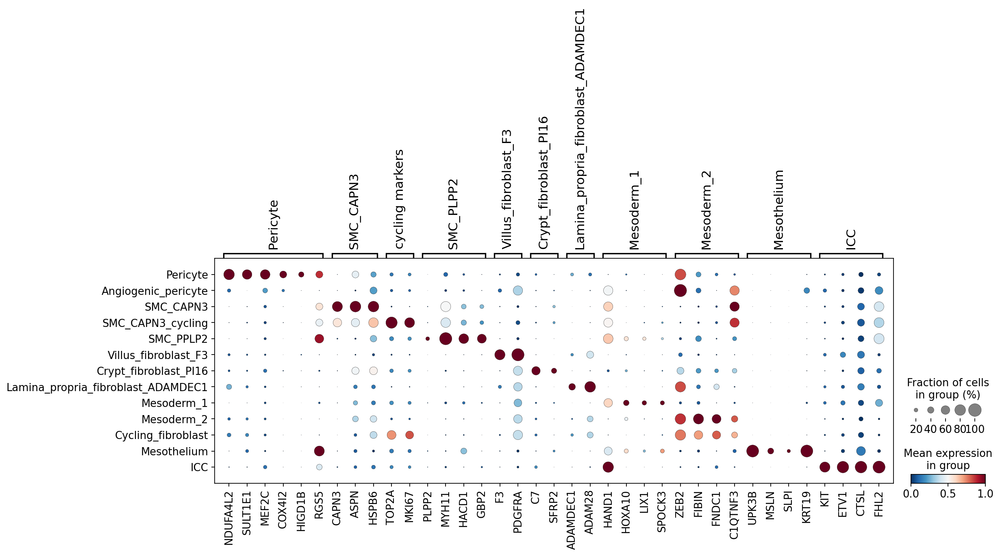

In [49]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_annot',save='Mes_FT_markers.pdf',color_map='RdBu_r', standard_scale='var')

In [50]:
adata = adata[~adata.obs.annot_v3.isin(['Angiogenic_pericyte'])].copy()

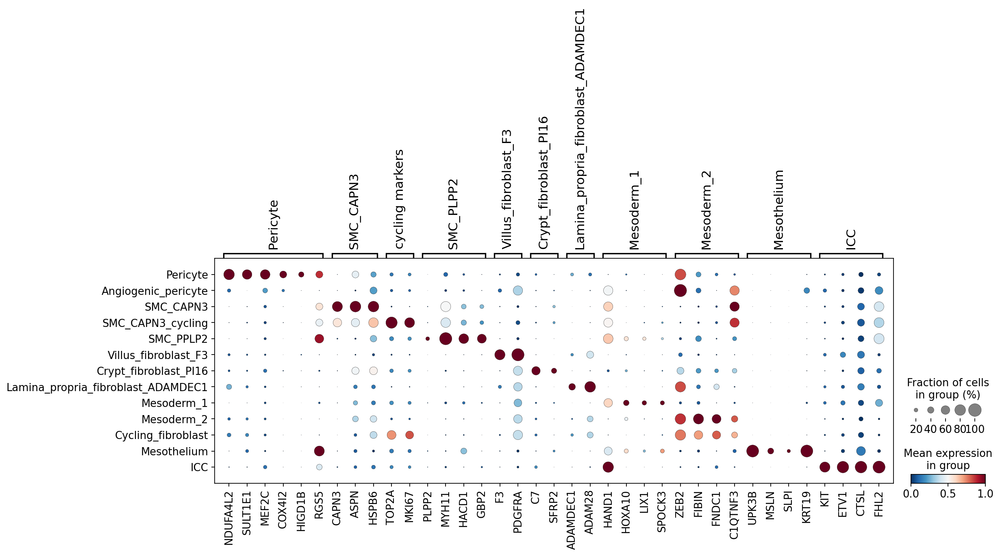

In [51]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_annot',save='Mes_FT_markers.pdf',color_map='RdBu_r', standard_scale='var')

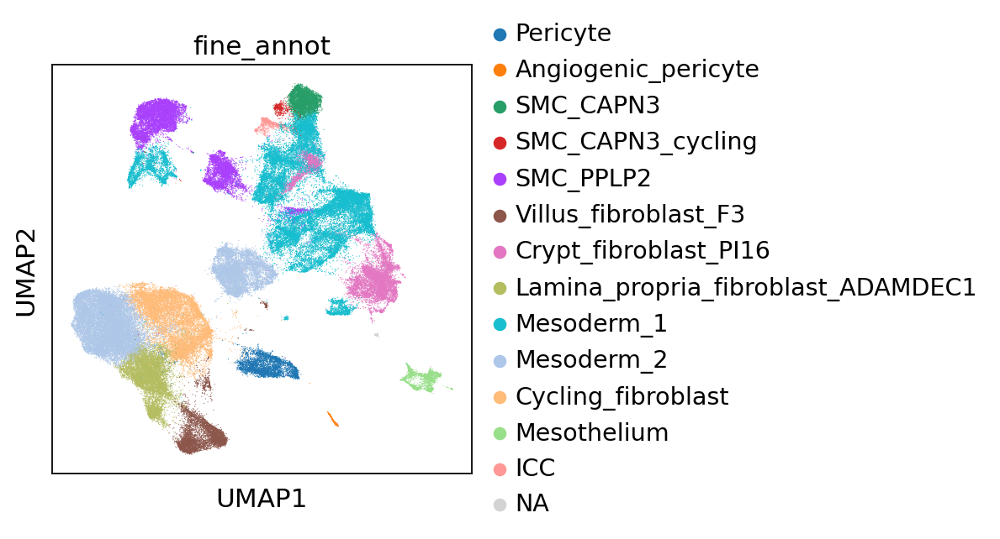

In [52]:
sc.pl.umap(adata,color='fine_annot')

In [53]:
adata = adata[adata.obs.fine_annot.isin([ 'Crypt_fibroblast_PI16', 'Cycling_fibroblast',
       'ICC', 'Lamina_propria_fibroblast_ADAMDEC1', 'Mesoderm_1', 'Mesoderm_2',
       'Mesothelium', 'Pericyte', 'SMC_CAPN3', 'SMC_CAPN3_cycling',
       'SMC_PPLP2', 'Villus_fibroblast_F3'])].copy()

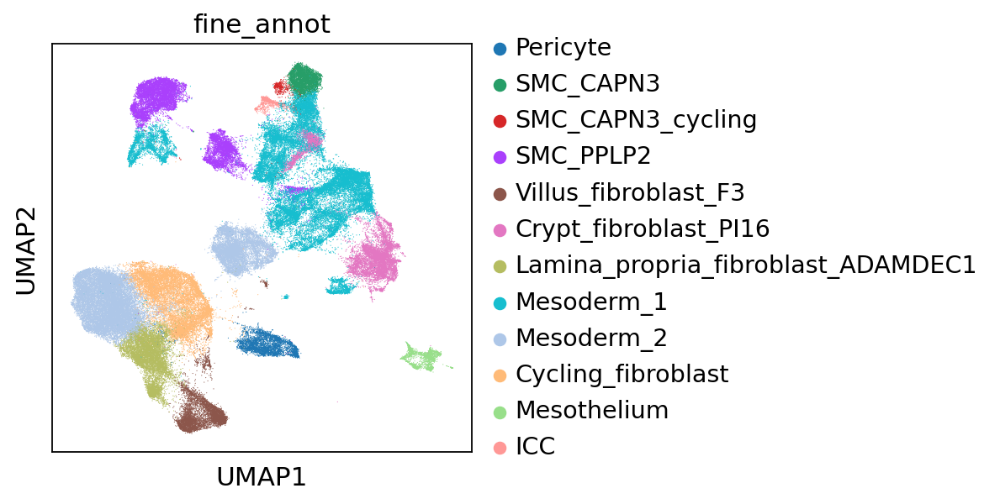

In [54]:
sc.pl.umap(adata,color='fine_annot')

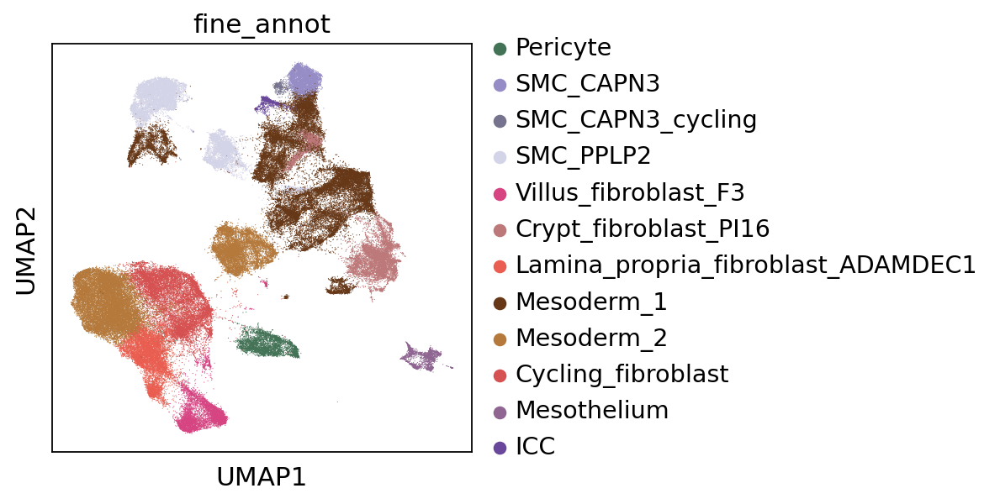

In [61]:
sc.pl.umap(adata,color='fine_annot',palette = [
                                                  '#437356',#'Pericyte',
    
    '#968dc6',#SMC_CAPN3 
 '#76738e',#    'SMC_CAPN3_cycling': 
'#d4d4e8',#  'SMC_PPLP2': 

                                                    '#d64582',#'Villus_fibroblast_F3'
                                               '#bd7879',#'Crypt_fibroblast_PI16', 
      
          
           '#e95e50',#'Lamina_propria_fibroblast_ADAMDEC1', 
           
           
    '#663818',#      'Mesoderm_1': 
'#b4793b',  #     'Mesoderm_2': 
    '#d65151',#Cycling_fibroblast': 

                                               '#8F6592',#'Mesothelium', 
          '#69479b' #ICC

           
          
                                              ])

In [62]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=300,dpi_save=600)

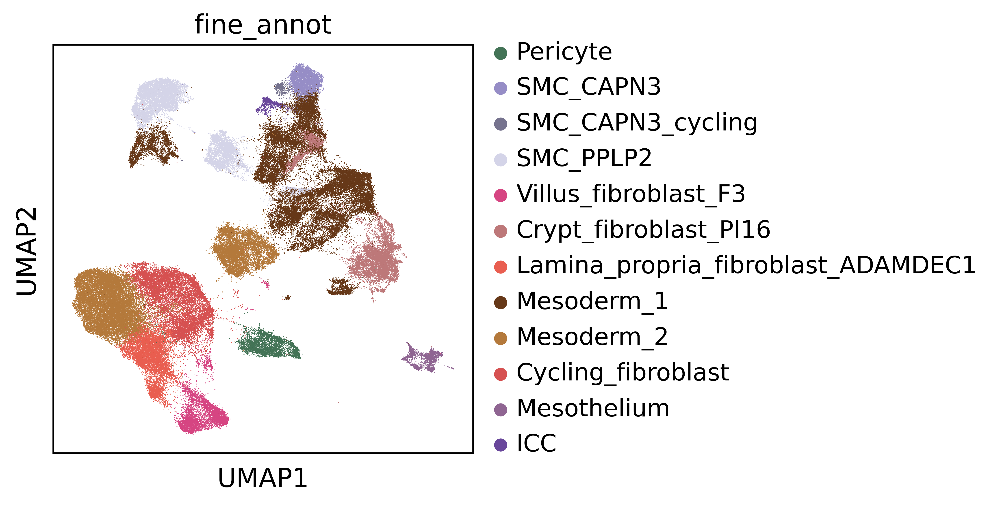

In [63]:
sc.pl.umap(adata,color='fine_annot',save='Mes_FT_annot.png')

<AxesSubplot: title={'center': 'fine_annot'}, xlabel='UMAP1', ylabel='UMAP2'>

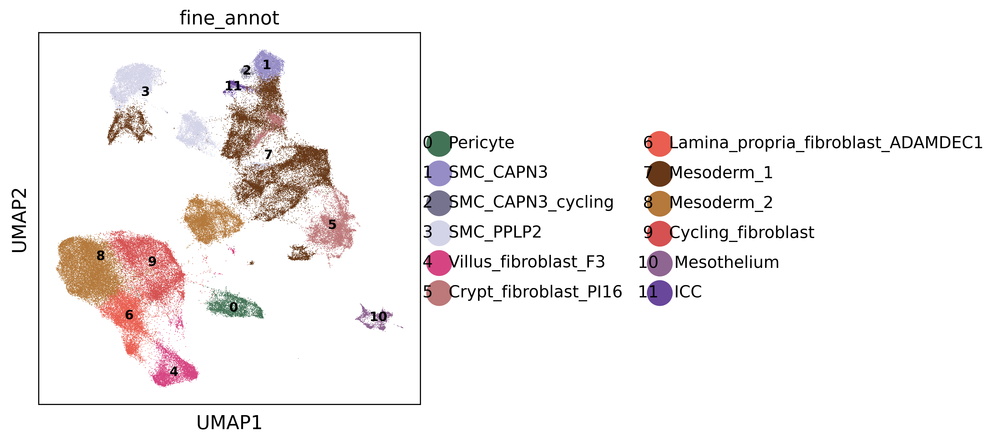

In [64]:
import sctk as sk
sk.plot_embedding(
    adata,
    basis="umap",
    groupby="fine_annot",
    figsize=(5, 5),
    save='figures/Mes_FT_annot.png')

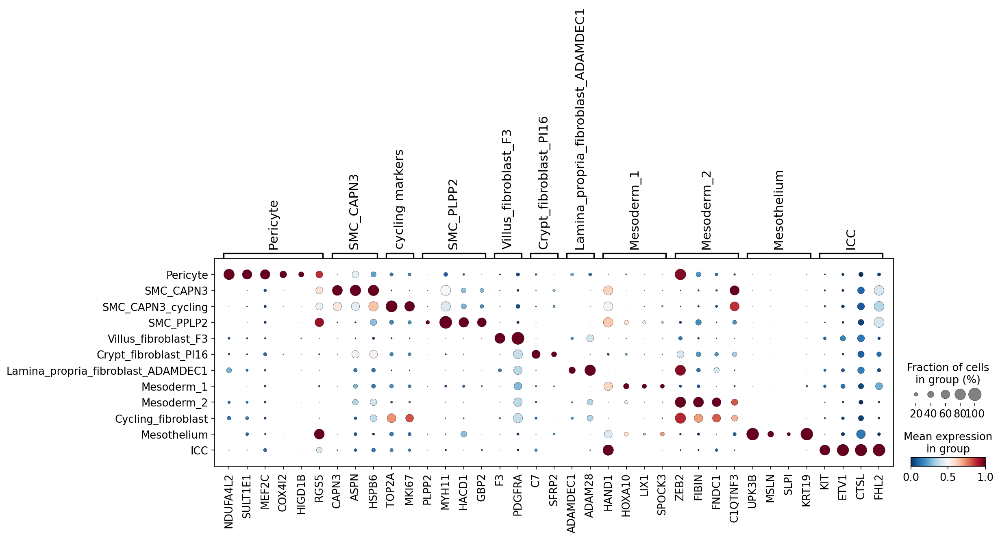

In [66]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_annot',save='Mes_FT_markers.pdf',color_map='RdBu_r', standard_scale='var')

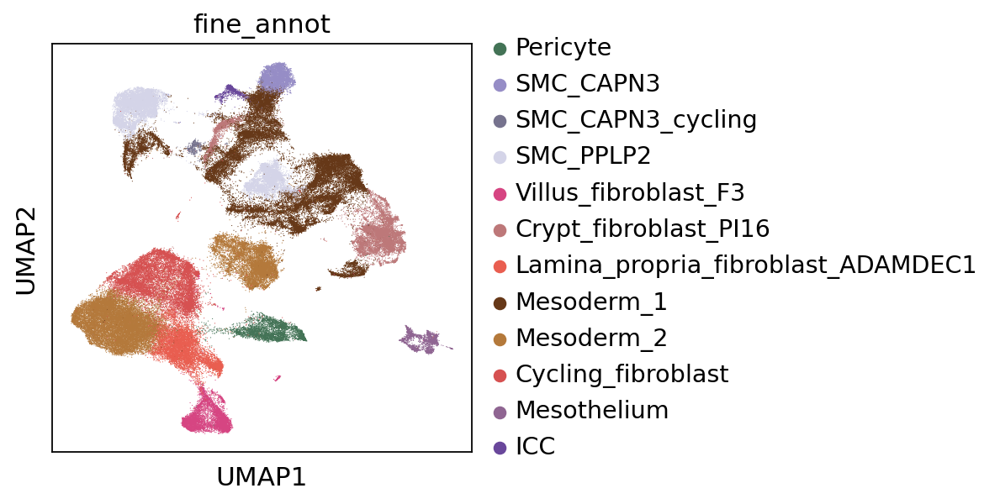

In [67]:
sc.pp.neighbors(
            adata,
            use_rep="X_scvi",
            n_pcs=adata.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(adata, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(adata, color='fine_annot')

In [68]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=300,dpi_save=600)

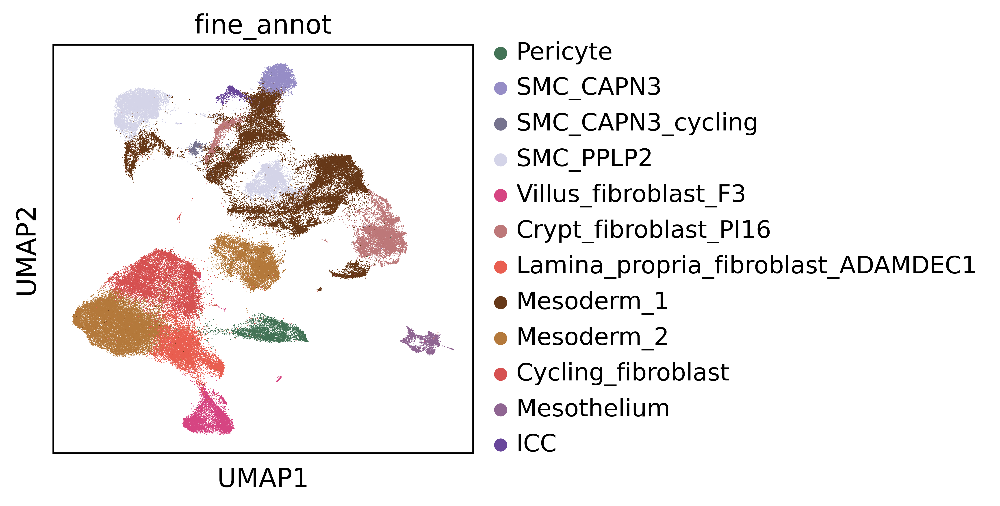

In [69]:
sc.pl.umap(adata,color='fine_annot',save='Mes_FT_annot.png')

<AxesSubplot: title={'center': 'fine_annot'}, xlabel='UMAP1', ylabel='UMAP2'>

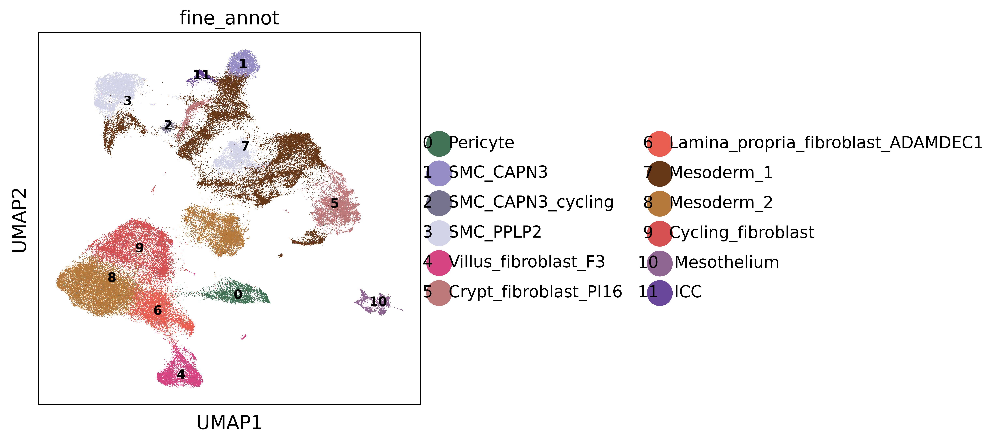

In [70]:
import sctk as sk
sk.plot_embedding(
    adata,
    basis="umap",
    groupby="fine_annot",
    figsize=(5, 5),
    save='figures/Mes_FT_annot.png')